## Detectron2 based Cascade RCNN for Survivor Detection

In [ ]:
%cd ..
from google.colab import drive
drive.mount('/content/gdrive')
!ln -s /content/gdrive/My\ Drive/ /mydrive # creating a symbolic link so that now the path /content/gdrive/My\ Drive/ is equal to /mydrive
%cd /mydrive/Final_Year_Project/RetinaNet

/
Mounted at /content/gdrive
/content/gdrive/My Drive/Final_Year_Project/RetinaNet


In [ ]:
!nvidia-smi

Sat May 27 15:49:54 2023       
+-----------------------------------------------------------------------------+
| NVIDIA-SMI 525.85.12    Driver Version: 525.85.12    CUDA Version: 12.0     |
|-------------------------------+----------------------+----------------------+
| GPU  Name        Persistence-M| Bus-Id        Disp.A | Volatile Uncorr. ECC |
| Fan  Temp  Perf  Pwr:Usage/Cap|         Memory-Usage | GPU-Util  Compute M. |
|                               |                      |               MIG M. |
|===============================+======================+======================|
|   0  Tesla T4            Off  | 00000000:00:04.0 Off |                    0 |
| N/A   51C    P8    10W /  70W |      0MiB / 15360MiB |      0%      Default |
|                               |                      |                  N/A |
+-------------------------------+----------------------+----------------------+
                                                                               
+-------

## Installing Detectron2 and dependencies

In [ ]:
!python -m pip install 'git+https://github.com/facebookresearch/detectron2.git'

Looking in indexes: https://pypi.org/simple, https://us-python.pkg.dev/colab-wheels/public/simple/
  Cloning https://github.com/facebookresearch/detectron2.git to /tmp/pip-req-build-o1bp6tqo
  Running command git clone --filter=blob:none --quiet https://github.com/facebookresearch/detectron2.git /tmp/pip-req-build-o1bp6tqo
  Resolved https://github.com/facebookresearch/detectron2.git to commit 3c7bb714795edc7a96c9a1a6dd83663ecd293e36
  Preparing metadata (setup.py) ... done
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 50.2/50.2 kB 3.1 MB/s eta 0:00:00
  Preparing metadata (setup.py) ... done
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 79.5/79.5 kB 9.2 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 154.5/154.5 kB 18.9 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 1.7/1.7 MB 46.4 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 117.0/117.0 kB 16.2 MB/s eta 0:00:00
  Preparing metadata (setup.py) ... done
  Created wheel for detectron2: filena

Confirming right versions of the libraries at disposal.

In [ ]:
import torch, detectron2
!nvcc --version
TORCH_VERSION = ".".join(torch.__version__.split(".")[:2])
CUDA_VERSION = torch.__version__.split("+")[-1]
print("torch: ", TORCH_VERSION, "; cuda: ", CUDA_VERSION)
print("detectron2:", detectron2.__version__)

nvcc: NVIDIA (R) Cuda compiler driver
Copyright (c) 2005-2022 NVIDIA Corporation
Built on Wed_Sep_21_10:33:58_PDT_2022
Cuda compilation tools, release 11.8, V11.8.89
Build cuda_11.8.r11.8/compiler.31833905_0
torch:  2.0 ; cuda:  cu118
detectron2: 0.6


In [ ]:
# COMMON LIBRARIES
import os
import cv2

from datetime import datetime
from google.colab.patches import cv2_imshow

# DATA SET PREPARATION AND LOADING
from detectron2.data.datasets import register_coco_instances
from detectron2.data import DatasetCatalog, MetadataCatalog

# VISUALIZATION
from detectron2.utils.visualizer import Visualizer
from detectron2.utils.visualizer import ColorMode

# CONFIGURATION
from detectron2 import model_zoo
from detectron2.config import get_cfg

# EVALUATION
from detectron2.engine import DefaultPredictor

# TRAINING
from detectron2.engine import DefaultTrainer

## Testing Detectron2 Model on test scenario

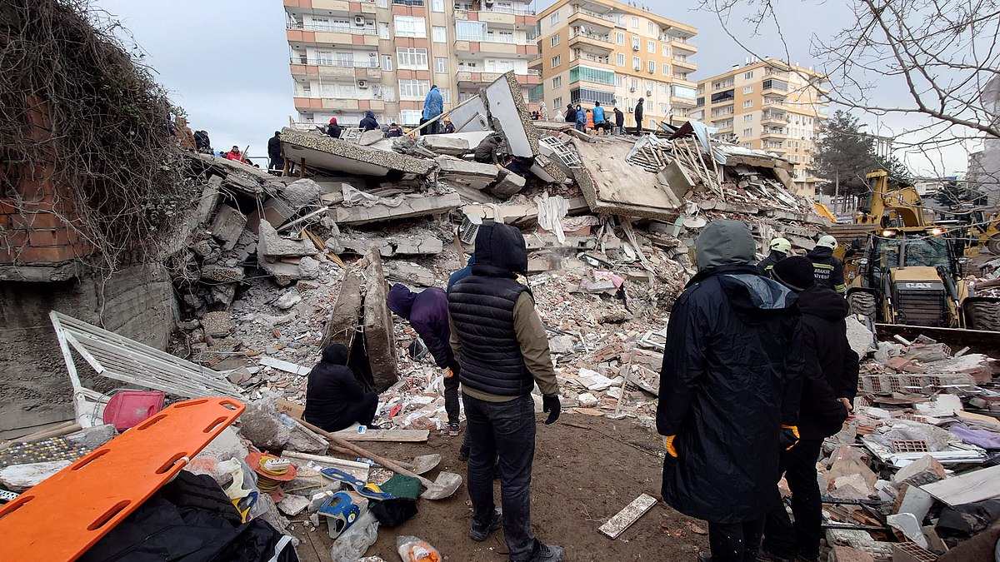

In [ ]:
!wget https://lh3.googleusercontent.com/-RjWeYNRRX7A/Y-ScPPcajNI/AAAAAAAAnrU/BFOtoYYntgwB3JNzFsC_mpwTMin17hqkgCNcBGAsYHQ/s1600/2023_Turkey_Earthquake_Damage.jpg -q -O input.jpg
# !wget http://images.cocodataset.org/val2017/10816_jpg.rf.da3c1b1e8355aaa055fdaeb0aa37003e.jpg -q -O input.jpg
image = cv2.imread("./input.jpg")
cv2_imshow(image)

In [ ]:
cfg = get_cfg()
cfg.merge_from_file(model_zoo.get_config_file("COCO-InstanceSegmentation/mask_rcnn_R_50_FPN_3x.yaml"))
cfg.MODEL.ROI_HEADS.SCORE_THRESH_TEST = 0.5
cfg.MODEL.WEIGHTS = model_zoo.get_checkpoint_url("COCO-InstanceSegmentation/mask_rcnn_R_50_FPN_3x.yaml")
predictor = DefaultPredictor(cfg)
outputs = predictor(image)

model_final_f10217.pkl: 178MB [00:01, 168MB/s]                           
/usr/local/lib/python3.10/dist-packages/torch/functional.py:504: UserWarning: torch.meshgrid: in an upcoming release, it will be required to pass the indexing argument. (Triggered internally at ../aten/src/ATen/native/TensorShape.cpp:3483.)
  return _VF.meshgrid(tensors, **kwargs)  # type: ignore[attr-defined]


In [ ]:
print(outputs["instances"].pred_classes)
print(outputs["instances"].pred_boxes)

tensor([0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 8, 8, 0, 0,
        0], device='cuda:0')
Boxes(tensor([[ 784.6600,  258.4618,  963.9556,  674.1535],
        [ 526.1198,  259.6699,  674.3878,  670.9954],
        [ 364.2704,  404.4719,  457.7512,  519.7230],
        [ 709.6783,  121.0332,  730.1306,  162.4333],
        [ 916.4042,  289.5507, 1020.5469,  671.5587],
        [ 321.1751,  156.9702,  340.0434,  210.7660],
        [ 689.8826,  125.0645,  702.5932,  158.3376],
        [ 736.4167,  128.0369,  749.8580,  162.9349],
        [ 430.5179,  134.5497,  454.3926,  158.7282],
        [ 760.2780,  116.9762,  772.9213,  162.0338],
        [ 392.4462,  139.8554,  409.1512,  166.3348],
        [ 462.8915,  336.4145,  551.9326,  517.7814],
        [ 270.4957,  174.3405,  290.2427,  193.5861],
        [ 503.1560,   98.3517,  532.9382,  161.2789],
        [ 463.2934,  147.7869,  483.1266,  164.9917],
        [ 677.7880,  123.7806,  691.5598,  148.1771],
        [ 966.3420,  

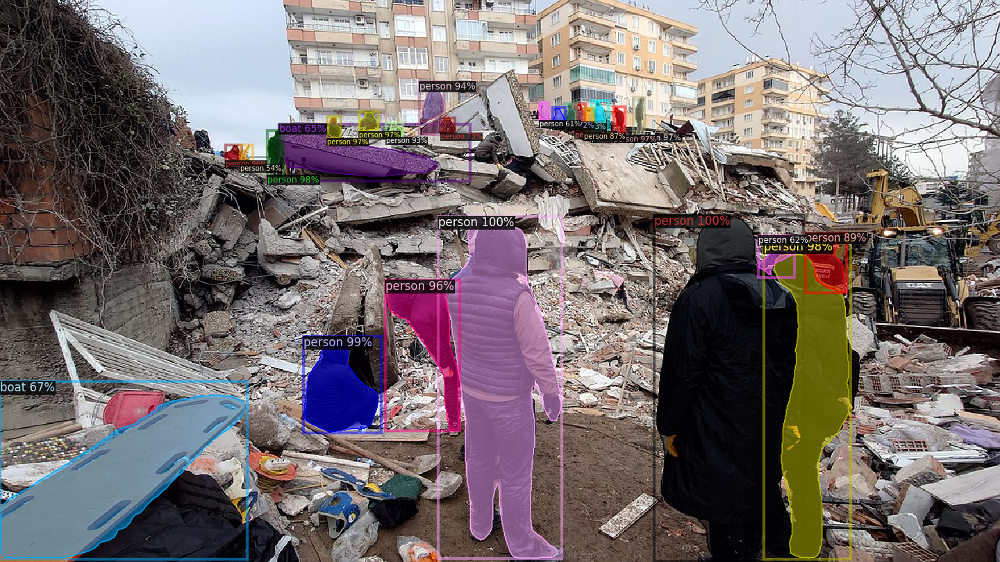

In [ ]:
visualizer = Visualizer(image[:, :, ::-1], MetadataCatalog.get(cfg.DATASETS.TRAIN[0]), scale=1.2)
out = visualizer.draw_instance_predictions(outputs["instances"].to("cpu"))
cv2_imshow(out.get_image()[:, :, ::-1])

## Formatting Survivor Detection Dataset to COCO JSON format

In [ ]:
%cd RescueNet

/content/gdrive/MyDrive/Final_Year_Project/RetinaNet/RescueNet


In [ ]:
from roboflow import Roboflow
rf = Roboflow(api_key="9KG0WhvnpHGdnlOuXdur")
project = rf.workspace("final-year-project-deylr").project("survivor-detection")
dataset = project.version(1).download("coco-segmentation")

loading Roboflow workspace...
loading Roboflow project...


Extracting Dataset Version Zip to Survivor-Detection-1 in coco-segmentation:: 100%|██████████| 246/246 [00:01<00:00, 143.06it/s]


### Registering dataset to Detectron2

In [ ]:
DATA_SET_NAME = dataset.name.replace(" ", "-")
ANNOTATIONS_FILE_NAME = "_annotations.coco.json"

In [ ]:
# TRAIN SET
TRAIN_DATA_SET_NAME = f"{DATA_SET_NAME}-train"
TRAIN_DATA_SET_IMAGES_DIR_PATH = os.path.join(dataset.location, "train")
TRAIN_DATA_SET_ANN_FILE_PATH = os.path.join(dataset.location, "train", ANNOTATIONS_FILE_NAME)

# register_coco_instances(
#     name=TRAIN_DATA_SET_NAME, 
#     metadata={}, 
#     json_file=TRAIN_DATA_SET_ANN_FILE_PATH, 
#     image_root=TRAIN_DATA_SET_IMAGES_DIR_PATH
# )

# TEST SET
TEST_DATA_SET_NAME = f"{DATA_SET_NAME}-test"
TEST_DATA_SET_IMAGES_DIR_PATH = os.path.join(dataset.location, "test")
TEST_DATA_SET_ANN_FILE_PATH = os.path.join(dataset.location, "test", ANNOTATIONS_FILE_NAME)

# register_coco_instances(
#     name=TEST_DATA_SET_NAME, 
#     metadata={}, 
#     json_file=TEST_DATA_SET_ANN_FILE_PATH, 
#     image_root=TEST_DATA_SET_IMAGES_DIR_PATH
# )

# VALID SET
VALID_DATA_SET_NAME = f"{DATA_SET_NAME}-valid"
VALID_DATA_SET_IMAGES_DIR_PATH = os.path.join(dataset.location, "valid")
VALID_DATA_SET_ANN_FILE_PATH = os.path.join(dataset.location, "valid", ANNOTATIONS_FILE_NAME)

# register_coco_instances(
#     name=VALID_DATA_SET_NAME, 
#     metadata={}, 
#     json_file=VALID_DATA_SET_ANN_FILE_PATH, 
#     image_root=VALID_DATA_SET_IMAGES_DIR_PATH
# )

Confirming that the survivor detection dataset is correctly registered using MetadataCatalog

In [ ]:
[
    data_set
    for data_set
    in MetadataCatalog.list()
    if data_set.startswith(DATA_SET_NAME)
]

['Survivor-Detection-train',
 'Survivor-Detection-test',
 'Survivor-Detection-valid']

### Visualizing survivor detection dataset

WARNING [05/27 17:28:38 d2.data.datasets.coco]: 
Category ids in annotations are not in [1, #categories]! We'll apply a mapping for you.

[05/27 17:28:38 d2.data.datasets.coco]: Loaded 207 images in COCO format from /content/gdrive/MyDrive/Final_Year_Project/RetinaNet/Survivor-Detection-1/train/_annotations.coco.json


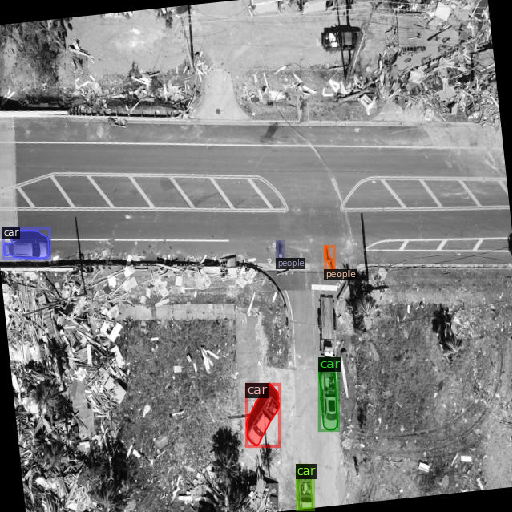

In [ ]:
metadata = MetadataCatalog.get(TRAIN_DATA_SET_NAME)
dataset_train = DatasetCatalog.get(TRAIN_DATA_SET_NAME)

dataset_entry = dataset_train[0]
image = cv2.imread(dataset_entry["file_name"])

visualizer = Visualizer(
    image[:, :, ::-1],
    metadata=metadata, 
    scale=0.8, 
    instance_mode=ColorMode.IMAGE_BW
)

out = visualizer.draw_dataset_dict(dataset_entry)
cv2_imshow(out.get_image()[:, :, ::-1])

## Training Cascade RCNN Model Using Custom COCO format Post disaster dataset 

### Model Configuration

In [ ]:
# HYPERPARAMETERS
ARCHITECTURE = "cascade_mask_rcnn_R_50_FPN_3x"
# ARCHITECTURE = "mask_rcnn_R_101_FPN_3x"
CONFIG_FILE_PATH = f"Misc/{ARCHITECTURE}.yaml"
MAX_ITER = 200
EVAL_PERIOD = 200
BASE_LR = 0.001
NUM_CLASSES = 2

# OUTPUT DIR
OUTPUT_DIR_PATH = os.path.join(
    DATA_SET_NAME, 
    ARCHITECTURE, 
    datetime.now().strftime('%Y-%m-%d-%H-%M-%S')
)

os.makedirs(OUTPUT_DIR_PATH, exist_ok=True)

In [ ]:
cfg = get_cfg()
cfg.merge_from_file(model_zoo.get_config_file(CONFIG_FILE_PATH))
cfg.MODEL.WEIGHTS = model_zoo.get_checkpoint_url(CONFIG_FILE_PATH)
cfg.DATASETS.TRAIN = (TRAIN_DATA_SET_NAME,)
cfg.DATASETS.TEST = (TEST_DATA_SET_NAME,)
cfg.MODEL.ROI_HEADS.BATCH_SIZE_PER_IMAGE = 64
cfg.TEST.EVAL_PERIOD = EVAL_PERIOD
cfg.DATALOADER.NUM_WORKERS = 2
cfg.SOLVER.IMS_PER_BATCH = 2
cfg.INPUT.MASK_FORMAT='bitmask'
cfg.SOLVER.BASE_LR = BASE_LR
cfg.SOLVER.MAX_ITER = MAX_ITER
cfg.MODEL.ROI_HEADS.NUM_CLASSES = NUM_CLASSES
cfg.OUTPUT_DIR = OUTPUT_DIR_PATH

### Training the Cascade RCNN model

In [ ]:
trainer = DefaultTrainer(cfg) 
trainer.resume_or_load(resume=False)
trainer.train()

[05/27 17:30:17 d2.engine.defaults]: Model:
GeneralizedRCNN(
  (backbone): FPN(
    (fpn_lateral2): Conv2d(256, 256, kernel_size=(1, 1), stride=(1, 1))
    (fpn_output2): Conv2d(256, 256, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
    (fpn_lateral3): Conv2d(512, 256, kernel_size=(1, 1), stride=(1, 1))
    (fpn_output3): Conv2d(256, 256, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
    (fpn_lateral4): Conv2d(1024, 256, kernel_size=(1, 1), stride=(1, 1))
    (fpn_output4): Conv2d(256, 256, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
    (fpn_lateral5): Conv2d(2048, 256, kernel_size=(1, 1), stride=(1, 1))
    (fpn_output5): Conv2d(256, 256, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
    (top_block): LastLevelMaxPool()
    (bottom_up): ResNet(
      (stem): BasicStem(
        (conv1): Conv2d(
          3, 64, kernel_size=(7, 7), stride=(2, 2), padding=(3, 3), bias=False
          (norm): FrozenBatchNorm2d(num_features=64, eps=1e-05)
        )
      )
      (res

roi_heads.box_predictor.0.cls_score.{bias, weight}
roi_heads.box_predictor.1.cls_score.{bias, weight}
roi_heads.box_predictor.2.cls_score.{bias, weight}
roi_heads.mask_head.predictor.{bias, weight}


[05/27 17:30:17 d2.engine.train_loop]: Starting training from iteration 0
[05/27 17:30:25 d2.utils.events]:  eta: 0:01:03  iter: 19  total_loss: 5.963  loss_cls_stage0: 0.9566  loss_box_reg_stage0: 0.38  loss_cls_stage1: 1.076  loss_box_reg_stage1: 0.6683  loss_cls_stage2: 1.098  loss_box_reg_stage2: 0.654  loss_mask: 0.6867  loss_rpn_cls: 0.1822  loss_rpn_loc: 0.08484    time: 0.3592  last_time: 0.3650  data_time: 0.0210  last_data_time: 0.0221   lr: 9.5905e-05  max_mem: 3256M
[05/27 17:30:32 d2.utils.events]:  eta: 0:00:58  iter: 39  total_loss: 4.72  loss_cls_stage0: 0.6498  loss_box_reg_stage0: 0.4498  loss_cls_stage1: 0.6667  loss_box_reg_stage1: 0.7533  loss_cls_stage2: 0.6097  loss_box_reg_stage2: 0.7109  loss_mask: 0.5771  loss_rpn_cls: 0.1818  loss_rpn_loc: 0.0627    time: 0.3680  last_time: 0.3216  data_time: 0.0092  last_data_time: 0.0065   lr: 0.00019581  max_mem: 3256M
[05/27 17:30:40 d2.utils.events]:  eta: 0:00:52  iter: 59  total_loss: 4.289  loss_cls_stage0: 0.3795  lo

In [ ]:
import locale
def getpreferredencoding(do_setlocale = True):
    return "UTF-8"
locale.getpreferredencoding = getpreferredencoding
!lsof -i:6006

COMMAND    PID USER   FD   TYPE DEVICE SIZE/OFF NODE NAME
tensorboa 4506 root   10u  IPv4 183273      0t0  TCP localhost:6006 (LISTEN)


In [ ]:
!kill -9 4506

In [ ]:
# Look at training curves in tensorboard:
# !kill 6006
%load_ext tensorboard
%tensorboard --logdir $OUTPUT_DIR_PATH

The tensorboard extension is already loaded. To reload it, use:
  %reload_ext tensorboard


<IPython.core.display.Javascript object>

### Evaluation of trained model

In [ ]:
cfg.MODEL.WEIGHTS = os.path.join(cfg.OUTPUT_DIR, "model_final.pth")
cfg.MODEL.ROI_HEADS.SCORE_THRESH_TEST = 0.7
predictor = DefaultPredictor(cfg)

[05/27 17:40:31 d2.checkpoint.detection_checkpoint]: [DetectionCheckpointer] Loading from Survivor-Detection/cascade_mask_rcnn_R_50_FPN_3x/2023-05-27-17-30-11/model_final.pth ...


WARNING [05/27 17:40:35 d2.data.datasets.coco]: 
Category ids in annotations are not in [1, #categories]! We'll apply a mapping for you.

[05/27 17:40:35 d2.data.datasets.coco]: Loaded 18 images in COCO format from /content/gdrive/MyDrive/Final_Year_Project/RetinaNet/Survivor-Detection-1/valid/_annotations.coco.json


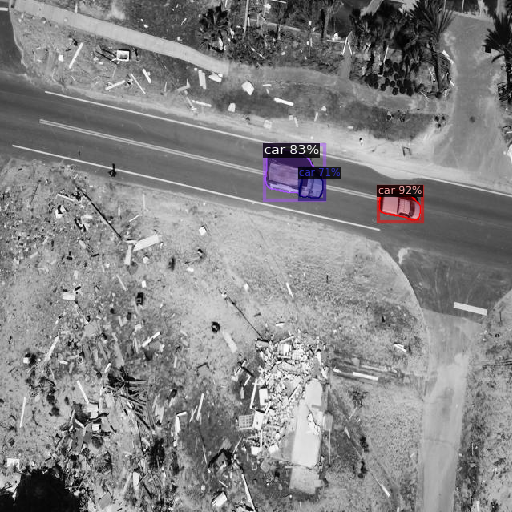

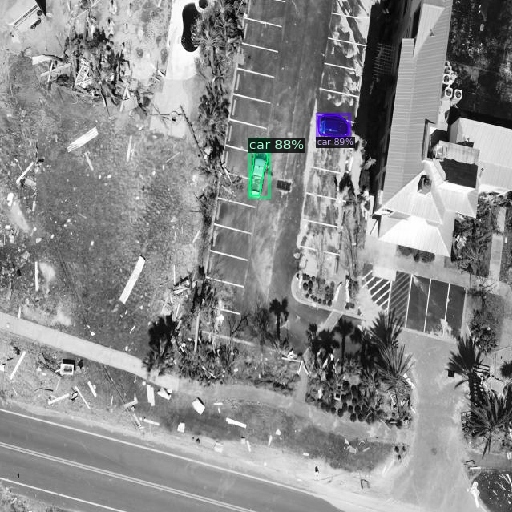

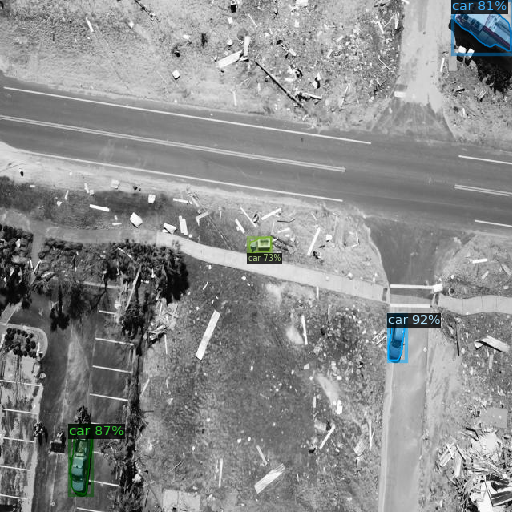

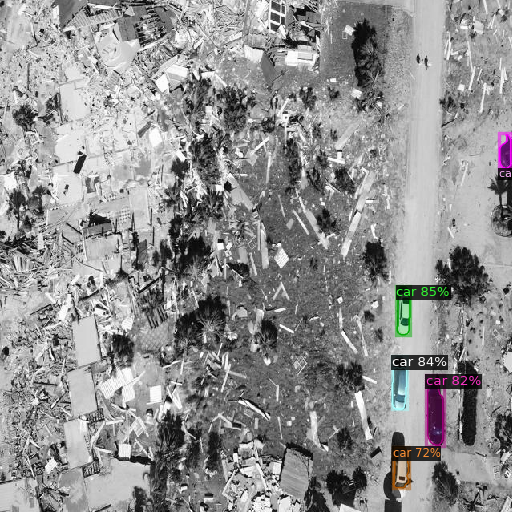

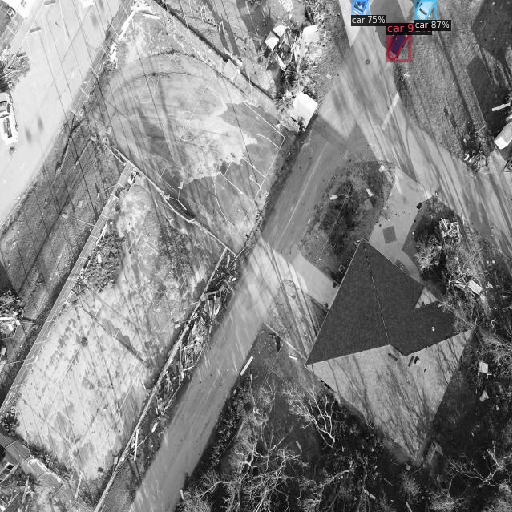

...

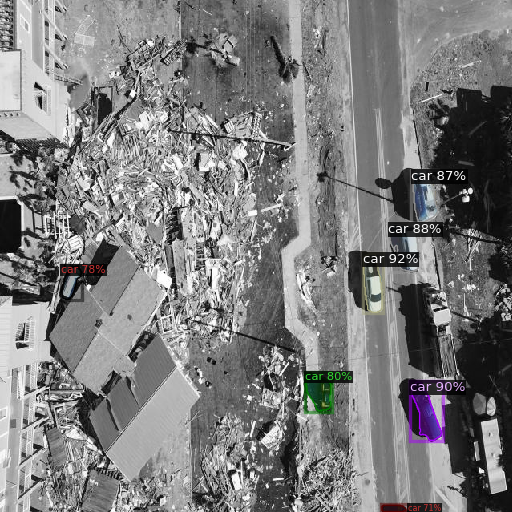

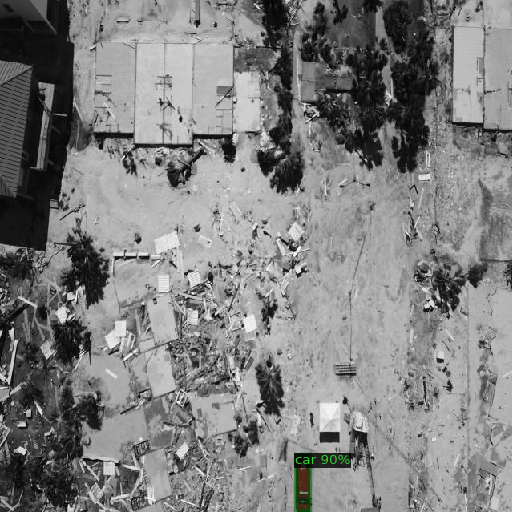

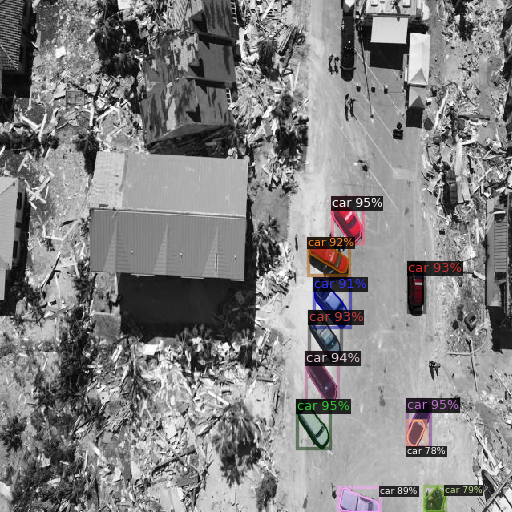

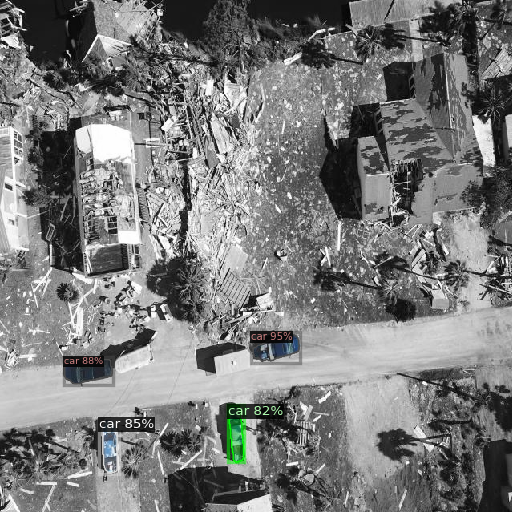

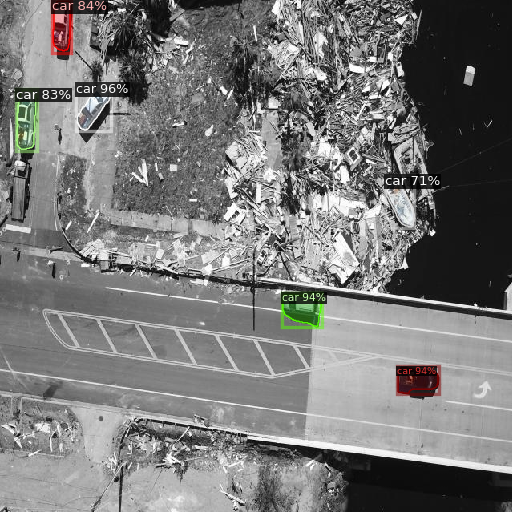

In [ ]:
dataset_valid = DatasetCatalog.get(VALID_DATA_SET_NAME)

for d in dataset_valid:
    img = cv2.imread(d["file_name"])
    outputs = predictor(img)
    
    visualizer = Visualizer(
        img[:, :, ::-1],
        metadata=metadata, 
        scale=0.8, 
        instance_mode=ColorMode.IMAGE_BW
    )
    out = visualizer.draw_instance_predictions(outputs["instances"].to("cpu"))
    cv2_imshow(out.get_image()[:, :, ::-1])

In [ ]:
torch.save(trainer.model.state_dict(), os.path.join("/content/gdrive/MyDrive/Final_Year_Project/RetinaNet/RescueNet", "mymodel.pth"))